link: https://towardsdatascience.com/a-step-by-step-guide-in-detecting-causal-relationships-using-bayesian-structure-learning-in-python-c20c6b31cee5

--> implement bayesian network to learn causal relationships


https://erdogant.github.io/bnlearn/pages/html/Examples.html


[df2onehot] >Auto detecting dtypes.


100%|██████████| 25/25 [00:00<00:00, 1273.44it/s]


[df2onehot] >Set dtypes in dataframe..


100%|██████████| 25/25 [00:00<00:00, 1633.45it/s]

[df2onehot] >Total onehot features: 22
[bnlearn] >Computing best DAG using [hc]
[bnlearn] >Set scoring type at [bic]


[bnlearn] >Compute structure scores for model comparison (higher is better).
[bnlearn] >Set node properties.
[bnlearn] >Set edge properties.
[bnlearn] >Plot based on Bayesian model


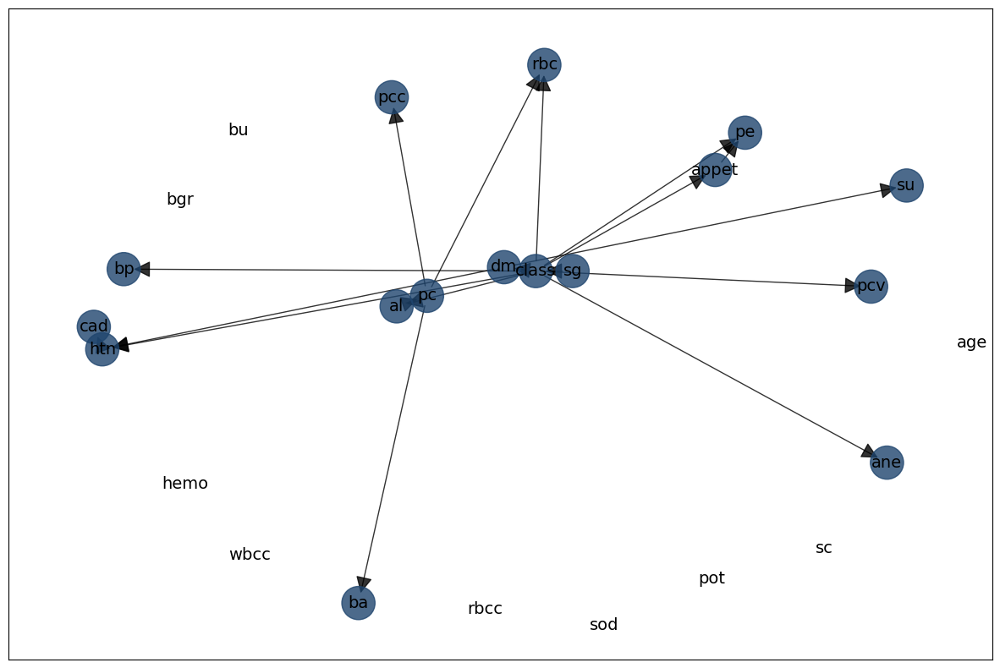

In [13]:
# !pip install bnlearn
import bnlearn as bn
import pandas as pd
# Load sprinkler dataset

# Print to screen for illustration
df = pd.read_csv('preprocessed/df_imputed.csv')
# Pre-processing of the input dataset
dfhot, dfnum = bn.df2onehot(df)

# Structure learning
DAG = bn.structure_learning.fit(df)

# Plot
G = bn.plot(DAG)
    
    

# # Learn the DAG in data using Bayesian structure learning:
# # Structure learning
# model = bn.structure_learning.fit(df, methodtype='hc', scoretype='bic')
# G = bn.plot(model)


In [14]:
# Parameter learning
model = bn.parameter_learning.fit(DAG, df)

[bnlearn] >Parameter learning> Computing parameters using [bayes]
[bnlearn] >Converting [<class 'pgmpy.base.DAG.DAG'>] to BayesianNetwork model.
[bnlearn] >Converting adjmat to BayesianNetwork.
[bnlearn] >CPD of sg:
+-----------+----------+
| sg(1.005) | 0.153447 |
+-----------+----------+
| sg(1.01)  | 0.223128 |
+-----------+----------+
| sg(1.015) | 0.214233 |
+-----------+----------+
| sg(1.02)  | 0.219422 |
+-----------+----------+
| sg(1.025) | 0.18977  |
+-----------+----------+
[bnlearn] >CPD of class:
+---------------+-----+---------------------+------------+
| sg            | ... | sg(1.02)            | sg(1.025)  |
+---------------+-----+---------------------+------------+
| class(ckd)    | ... | 0.47297297297297297 | 0.44140625 |
+---------------+-----+---------------------+------------+
| class(notckd) | ... | 0.527027027027027   | 0.55859375 |
+---------------+-----+---------------------+------------+
[bnlearn] >CPD of al:
+---------+---------------------+----------------

In [15]:
print(df.head())


    age    bp     sg   al   su     rbc        pc         pcc          ba  \
0  48.0  80.0  1.020  1.0  0.0  normal    normal  notpresent  notpresent   
1   7.0  50.0  1.020  4.0  0.0  normal    normal  notpresent  notpresent   
2  62.0  80.0  1.010  2.0  3.0  normal    normal  notpresent  notpresent   
3  48.0  70.0  1.005  4.0  0.0  normal  abnormal     present  notpresent   
4  51.0  80.0  1.010  2.0  0.0  normal    normal  notpresent  notpresent   

     bgr  ...   pcv    wbcc  rbcc  htn   dm  cad  appet   pe  ane class  
0  121.0  ...  44.0  7800.0   5.2  yes  yes   no   good   no   no   ckd  
1   94.0  ...  38.0  6000.0   4.3   no   no   no   good   no   no   ckd  
2  423.0  ...  31.0  7500.0   4.2   no  yes   no   poor   no  yes   ckd  
3  117.0  ...  32.0  6700.0   3.9  yes   no   no   poor  yes  yes   ckd  
4  106.0  ...  35.0  7300.0   4.6   no   no   no   good   no   no   ckd  

[5 rows x 25 columns]


In [18]:
# Print CPDs
CPDs = bn.print_CPD(model)
# Make inference
q = bn.inference.fit(model, variables=['class'], evidence={'appet': 'good', 'htn': 'yes', 'rbc':'normal'})

## to do: we should split the data into training and test set and then do the inference on the test set 
# --> then we can validate the model and compare it to the other models (random forests, etc.)

print(q.df)
print(q._str())

[bnlearn] >Data is stored in [query.df]
+----+-------+----------+
|    |    sg |        p |
+====+=======+==========+
|  0 | 1.005 | 0.153447 |
+----+-------+----------+
|  1 | 1.01  | 0.223128 |
+----+-------+----------+
|  2 | 1.015 | 0.214233 |
+----+-------+----------+
|  3 | 1.02  | 0.219422 |
+----+-------+----------+
|  4 | 1.025 | 0.18977  |
+----+-------+----------+
CPD of sg:
+-----------+----------+
| sg(1.005) | 0.153447 |
+-----------+----------+
| sg(1.01)  | 0.223128 |
+-----------+----------+
| sg(1.015) | 0.214233 |
+-----------+----------+
| sg(1.02)  | 0.219422 |
+-----------+----------+
| sg(1.025) | 0.18977  |
+-----------+----------+
[bnlearn] >Data is stored in [query.df]
+----+---------+-------+----------+
|    | class   |    sg |        p |
+====+=========+=======+==========+
|  0 | ckd     | 1.005 | 0.516908 |
+----+---------+-------+----------+
|  1 | ckd     | 1.01  | 0.667774 |
+----+---------+-------+----------+
|  2 | ckd     | 1.015 | 0.653979 |
+----+--

[bnlearn] >Compute edge strength with [chi_square]
[bnlearn] >Set node properties.
[bnlearn]> Set edge weights based on the [chi_square] test statistic.
[bnlearn] >Set edge properties.
[bnlearn] >Plot based on Bayesian model


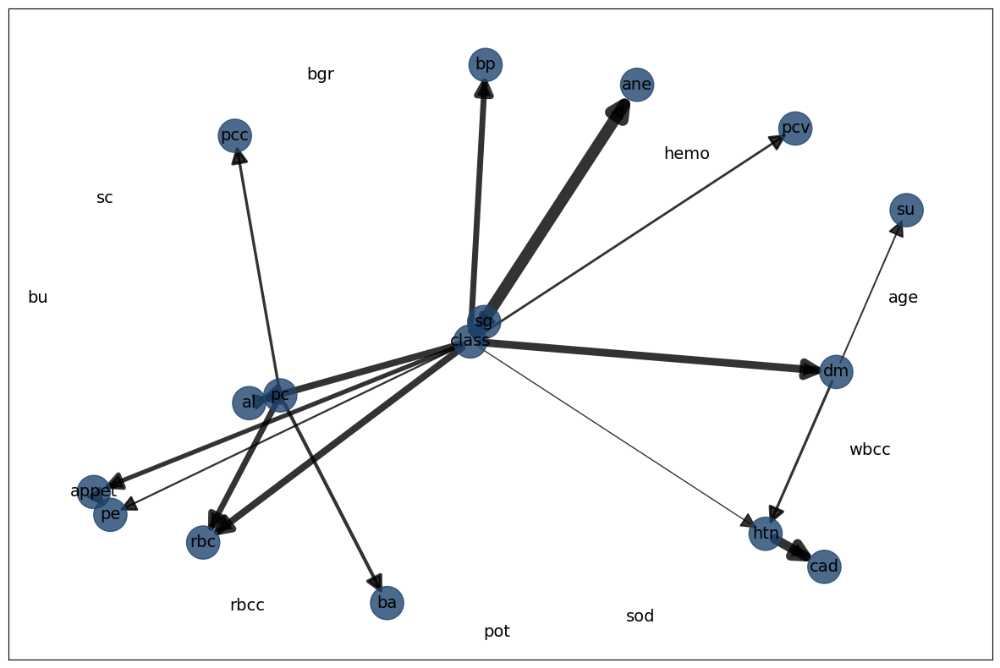

In [34]:

# Compute edge strength using chi-square independence test and remove (prune) the not-signficant edges
model = bn.independence_test(model, df, alpha=0.05, prune=True)

# Plot the DAG
G = bn.plot(model)

In [36]:
model['independence_test']

,source,target,stat_test,p_value,chi_square,dof
0,sg,class,True,6.146989e-39,185.046129,4
1,class,bp,True,8.589956e-11,66.156579,9
2,class,al,True,1.772724e-31,154.118400,5
3,class,rbc,True,8.051656e-06,19.925562,1
4,class,pcv,True,1.411796e-23,200.369532,39
5,class,htn,True,3.826551e-23,98.176757,1
6,class,dm,True,1.070104e-20,87.027727,1
7,class,appet,True,1.830635e-10,40.639552,1
8,class,pe,True,1.370437e-09,36.710439,1
9,class,ane,True,2.001350e-07,27.031807,1


In [37]:
model['adjmat']

target,age,bp,sg,al,su,rbc,pc,pcc,ba,bgr,...,pcv,wbcc,rbcc,htn,dm,cad,appet,pe,ane,class
source,,,,,,,,,,,,,,,,,,,,,
age,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
bp,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
sg,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,True
al,False,False,False,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False
su,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
rbc,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
pc,False,False,False,False,False,True,False,True,True,False,...,False,False,False,False,False,False,False,False,False,False
pcc,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
ba,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
